# Skin patches extraction

In [2]:
import sys
sys.path.append('/home/dasec-notebook/Thesis/OFIQ-Project/python')

import matplotlib.pyplot as plt

import os
import cv2
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

from ofiq_zmq import OfiqZmq
from utils import baseline_utils

%load_ext autoreload
%autoreload 2


In [2]:
ofiq_zmq = OfiqZmq('/home/dasec-notebook/Thesis/OFIQ-Project')

dataset_portrait_path = '/home/dasec-notebook/Thesis/Datasets/CHROMA-FIT-Dataset/DATA_CROPPED_PORTRAIT2'

# Generate dataset image lists

In [11]:
input_folder = '/home/dasec-notebook/Thesis/Datasets/CHROMA-FIT-Dataset/DATA_CROPPED_PORTRAIT2'
indoor_file = 'indoor.txt'
outdoor_file = 'outdoor.txt'

In [16]:
# Sort indoor and outdoor images for CHROMA-FIT-Dataset

with open(indoor_file, 'w') as indoor_f, open(outdoor_file, 'w') as outdoor_f:
    for subdir, _, files in os.walk(input_folder):
        for file in files:
            if file.lower().endswith(('.jpg', '.jpeg', '.png', ".JPEG", ".PNG", "JPG")):
                image_path = os.path.join(subdir, file)
                if baseline_utils.is_indoor(image_path):
                    indoor_f.write(image_path + '\n')
                else:
                    outdoor_f.write(image_path + '\n')

print(f"Indoor images saved to {indoor_file}")
print(f"Outdoor images saved to {outdoor_file}")


Indoor images saved to indoor.txt
Outdoor images saved to outdoor.txt


In [50]:
# Generate MST image list

# Iterate though a directory and write files to txt
input_folder = '/home/dasec-notebook/Thesis/Datasets/mst-e_data/mst-e_data_portrait'
mst_file = 'MST.txt'

with open(mst_file, 'w') as f:
    for subdir, _, files in os.walk(input_folder):
        for file in files:
            if file.lower().endswith(('.jpg', '.jpeg', '.png', ".JPEG", ".PNG", "JPG")):
                image_path = os.path.join(subdir, file)
                f.write(image_path + '\n')

Display all images

Used to double check the sorting of indoor and outdoor images from CHROMA-FIT dataset

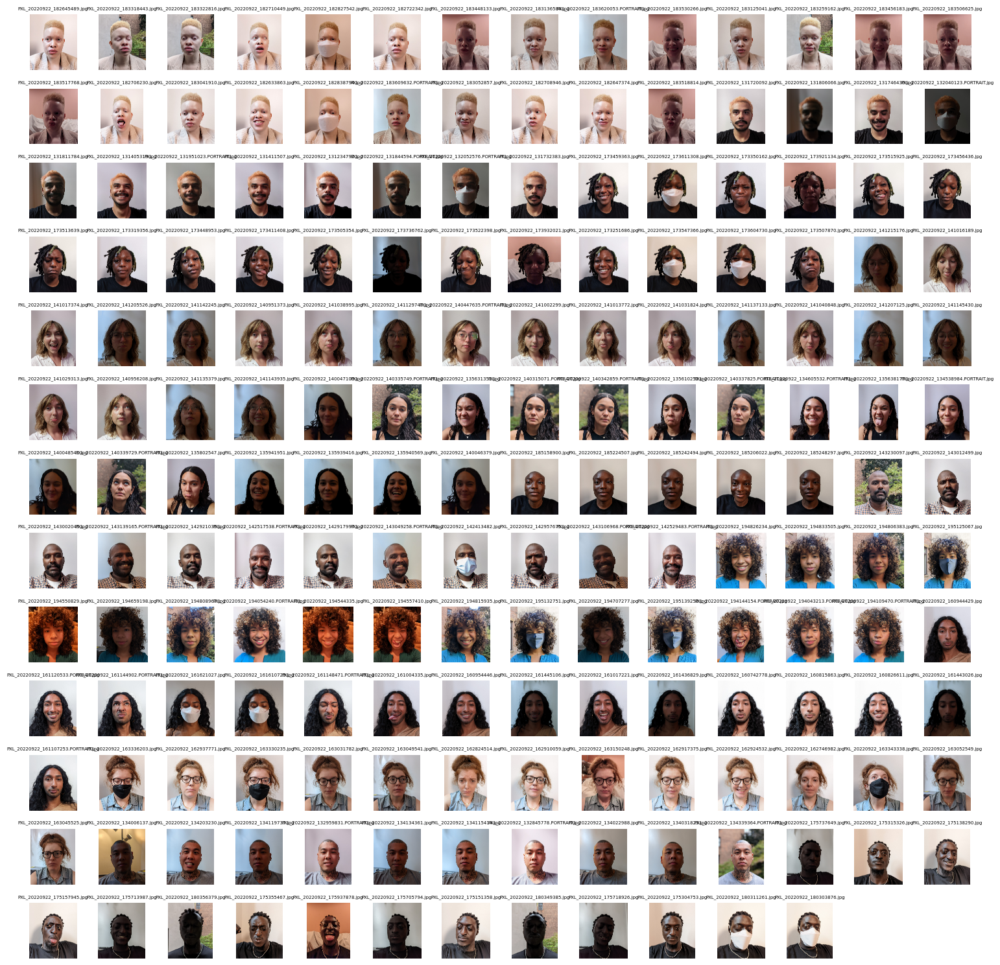

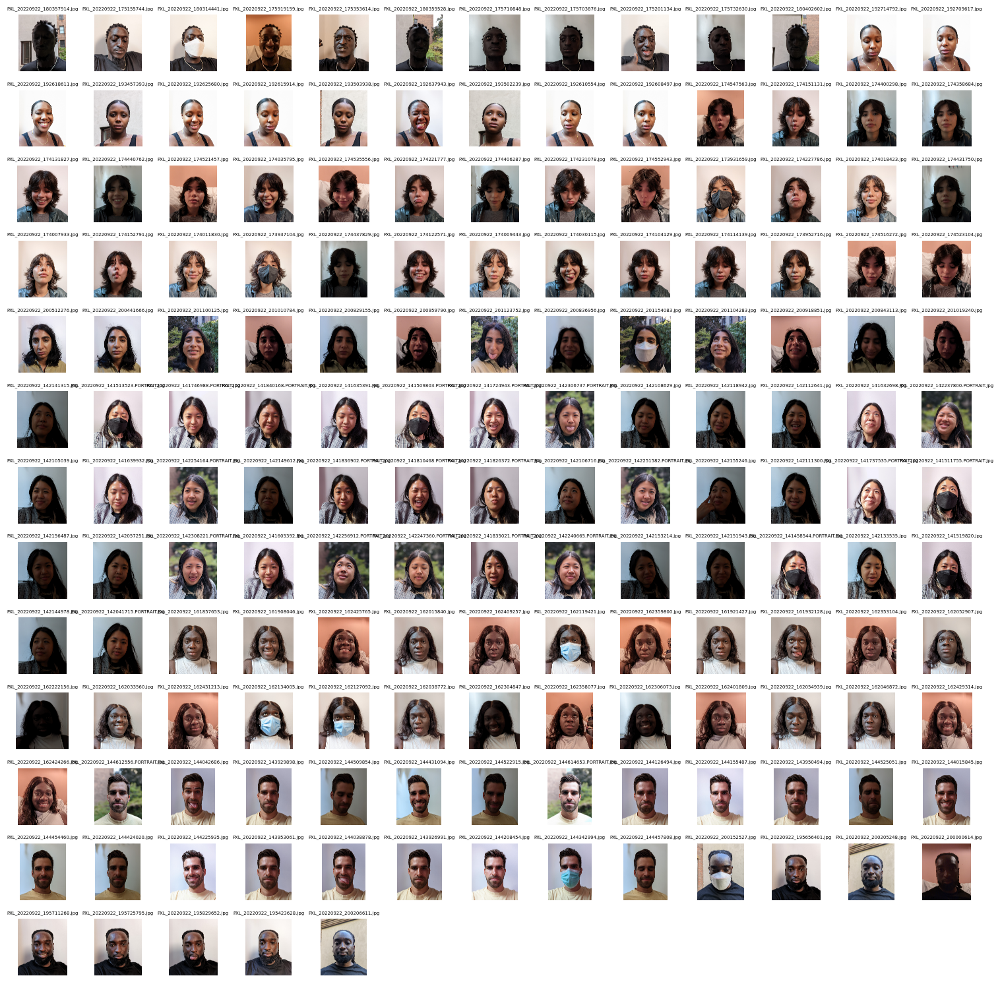

In [4]:
indoor_file = 'indoor.txt'
outdoor_file = 'outdoor.txt'
mst_file = 'MST.txt'

# Display all indoor images
baseline_utils.display_images(indoor_file)

# Display all outdoor images
baseline_utils.display_images(outdoor_file)

# Display all MST images
baseline_utils.display_images(mst_file)

# Plot 15 images with landmarks, mask and extracted skin patches

Used to visualize the cheek patches and landmark estimation.

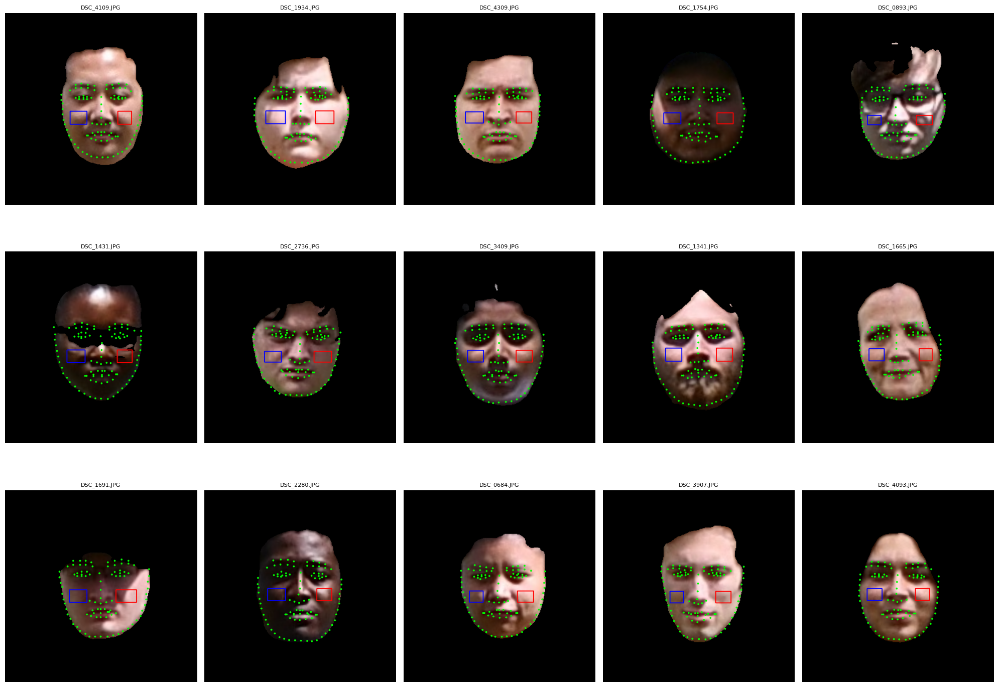

[OFIQ_zmq_app][INFO] Shutdown due to receive timeout.


In [12]:
file_path = 'outdoor.txt' # NOTE: change the file name to the required one

with open(file_path, 'r') as f:
    image_paths = [line.strip() for line in f if line.strip()]

# Get random 15 images from the txt file
# image_paths = random.sample(image_paths, min(15, len(image_paths)))

# select the first 15 images
image_paths = image_paths[:15]

rows, cols = 3,5
fig, axes = plt.subplots(rows, cols, figsize=(20, 15))
fig.subplots_adjust(wspace=0.05, hspace=0.05)  # Reduces gaps between images


for i, img_path in enumerate(image_paths):
    row, col = divmod(i, cols)
      
    # Process the image
    result = ofiq_zmq.process_image(img_path)
    img = result['aligned_face'][0]

    landmarks = np.array([[point.x, point.y] for point in result['aligned_face_landmarks'][1]])
    mask = result['face_occlusion_segmentation_image'][0]

    # NOTE: remove the mask to see the original image if needed
    masked_img = mask * img

    processed_img = baseline_utils.image_with_rect(masked_img, landmarks)
    
    # Display the image in the grid
    axes[row, col].imshow(cv2.cvtColor(processed_img, cv2.COLOR_BGR2RGB))
    axes[row, col].axis('off') 
    axes[row, col].set_title(os.path.basename(img_path), fontsize = 8)  

# Hide any unused subplots
for j in range(i + 1, rows * cols):
    row, col = divmod(j, cols)
    axes[row, col].axis('off')

plt.tight_layout()
plt.show()

# Extract the skin patches and save RGBs to a file

Extracts left and right check RGB and calculates the mean to determine the RGB color of a skin tone. 

One cheek RGB is calculated by averaging skin patches of size 10x10 and sliding it by the stride of 5 pixels.

In [6]:

with open("MST.txt", 'r') as f:
    image_paths = [line.strip() for line in f if line.strip()]

output_json_file = "baseline_results/MST_cheek_colors_results.json"  # Output JSON file name

baseline_utils.extract_skin_patch_RGBs(image_paths, output_json_file)

[OFIQ_zmq_app][INFO] ZeroMQ server bound to: tcp://*:40411


KeyboardInterrupt: 

[OFIQ_zmq_app][INFO] OFIQ initialized.
[OFIQ_zmq_app][INFO] Shutdown due to receive timeout.


# Calculate accuracy of baseline model

CHROMA-FIT

Generate Ground Truths for CHROMA-FIT dataset by mapping RGB to MST.

Mapping is described in CHROMA-FIT paper, and follows these steps:

1. Convert RGB values from the .CSV into linear RGB. 
2. Extract salient colors from each MST orb image using a K-means clustering algorithm. 
3. Calculate the Root Mean Square Error (RMSE) between the linear RGB values for each subject and the cluster centers obtained from the MST orbs. 
4. Assign an MST rating to each subject based on the orb with the lowest RMSE.

Calculation is based on forehead measurements. Experiments were done on the forearm measurement as well.

In [7]:
data = pd.read_csv('/home/dasec-notebook/Thesis/Datasets/CHROMA-FIT-Dataset/Metadata.csv')
mst_orb_dir = '/home/dasec-notebook/Thesis/Datasets/MST Orbs/orbs'
save_file = 'baseline_results/ground_truth_RGB_MST_forearm.csv'

# Load all MST orb salient colors in a dictionary
mst_orb_salient_colors = {}
for filename in os.listdir(mst_orb_dir):
    if filename.endswith(".png"): 
        image_path = os.path.join(mst_orb_dir, filename)
        salient_colors = baseline_utils.extract_salient_colors(image_path)
        mst_orb_salient_colors[filename] = salient_colors

results = []

# Iterate through each subject's Forearm RGB values
for index, row in data.iterrows():

    # Convert subject's Forearm RGB values to linear RGB
    forehead_rgb = [row['Forehead_R'], row['Forehead_G'], row['Forehead_B']]
    linear_forearm_rgb = baseline_utils.linear_rgb(forehead_rgb)

    best_mst_orb = None
    lowest_rmse = float('inf')
    
    # Compare against each MST orb's salient colors
    for mst_orb_name, salient_colors in mst_orb_salient_colors.items():

        linear_salient_colors = [baseline_utils.linear_rgb(color) for color in salient_colors]
        rmse, _ = baseline_utils.compute_rmse(linear_forearm_rgb, linear_salient_colors)
        
        if rmse < lowest_rmse:
            lowest_rmse = rmse
            best_mst_orb = mst_orb_name.split('.')[0].split('_')[1]  # Remove file extension
    
    results.append({
        'ID': row['ID'],
        'Ground_Truth_MST_Orb': best_mst_orb,  # Best MST orb file for this subject
        'Lowest_RMSE': lowest_rmse
    })

results_df = pd.DataFrame(results)
results_df.to_csv(save_file, index=False)

print("Best MST orbs calculated and saved to ", save_file)


Best MST orbs calculated and saved to  baseline_results/ground_truth_RGB_MST_forearm.csv


Visualise images of each MST category

Shows the ground truth classification of images.

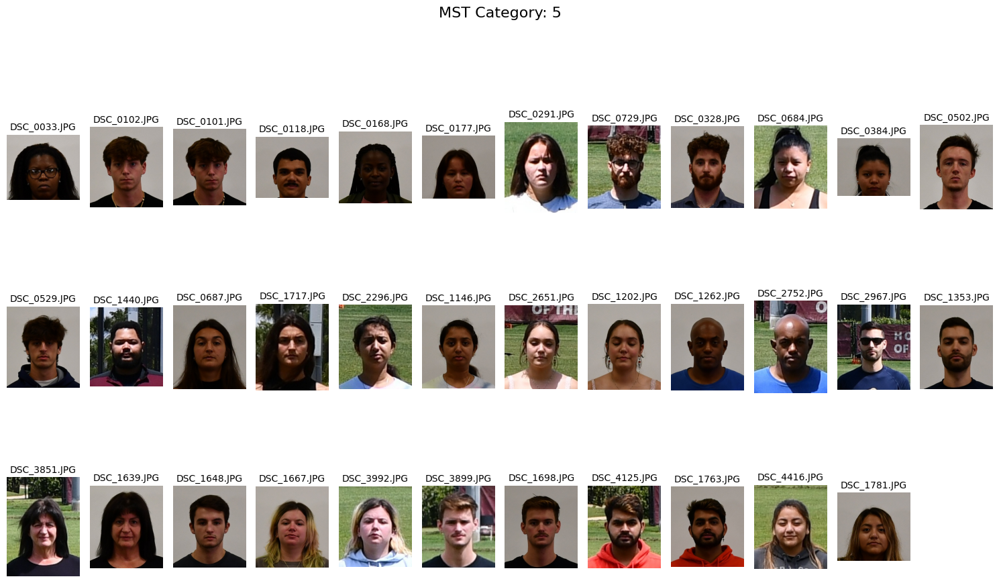

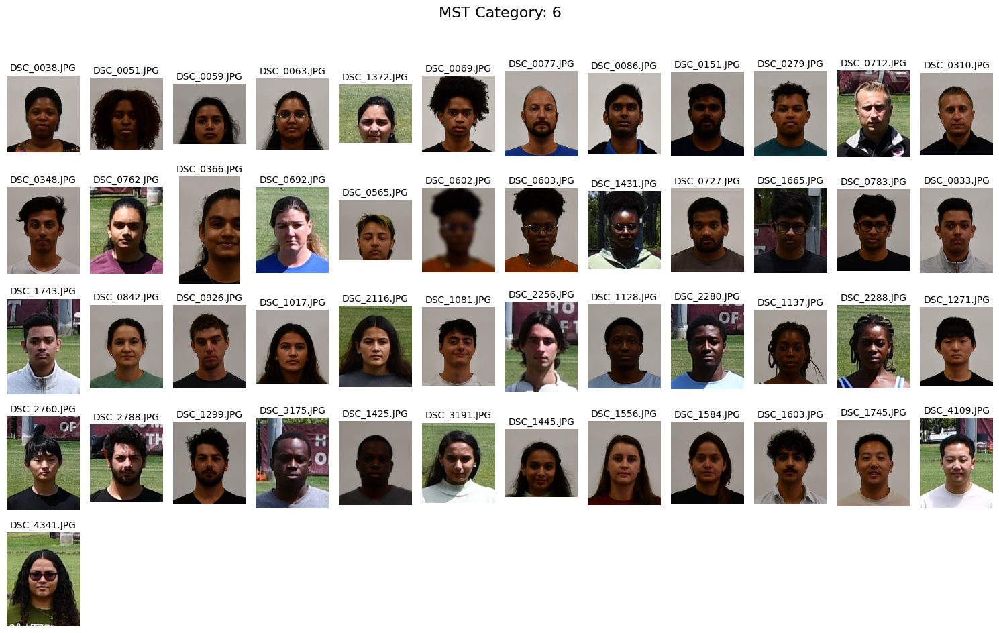

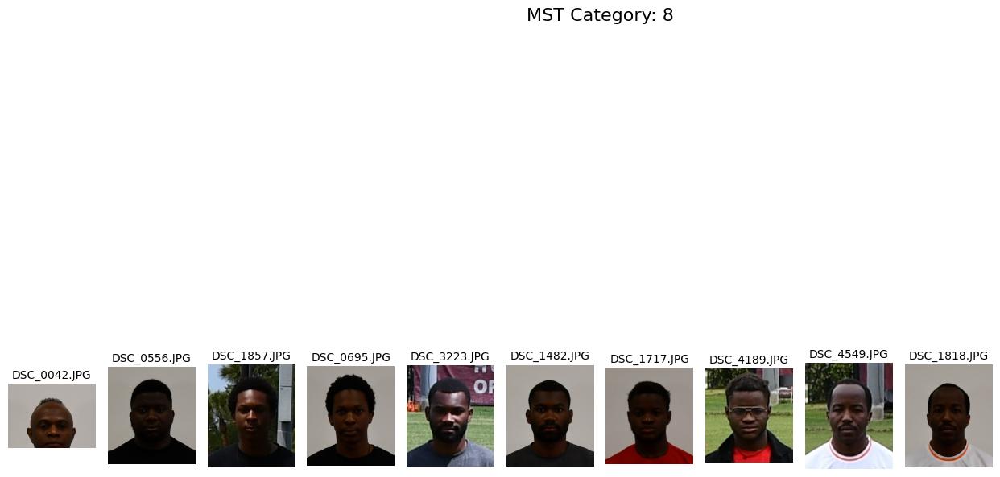

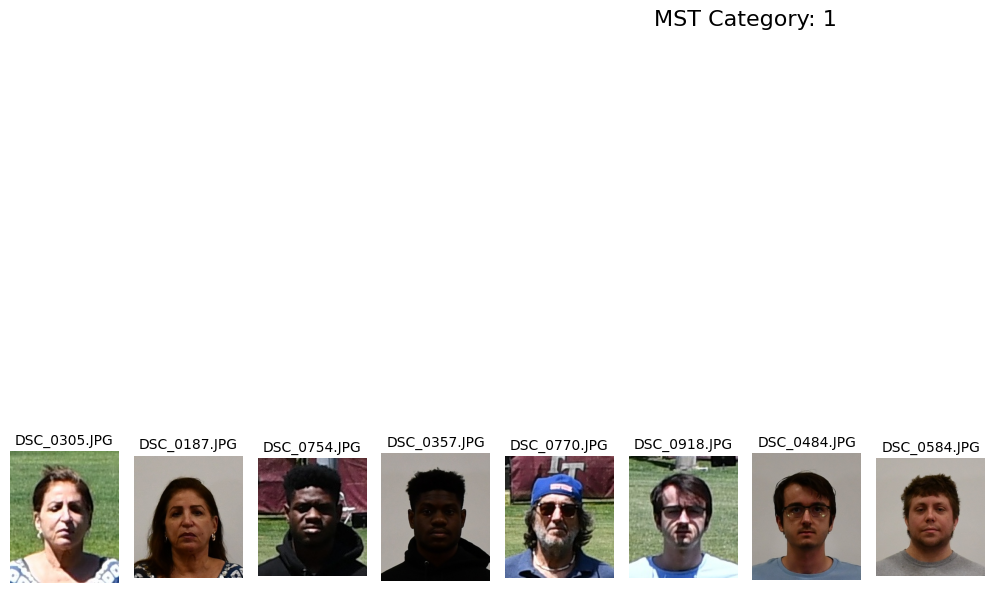

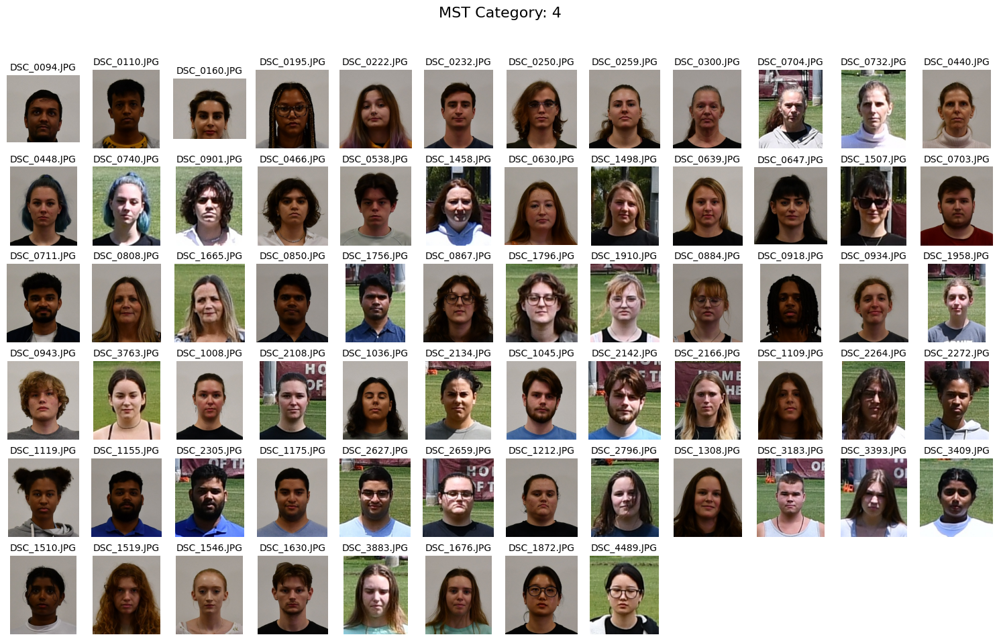

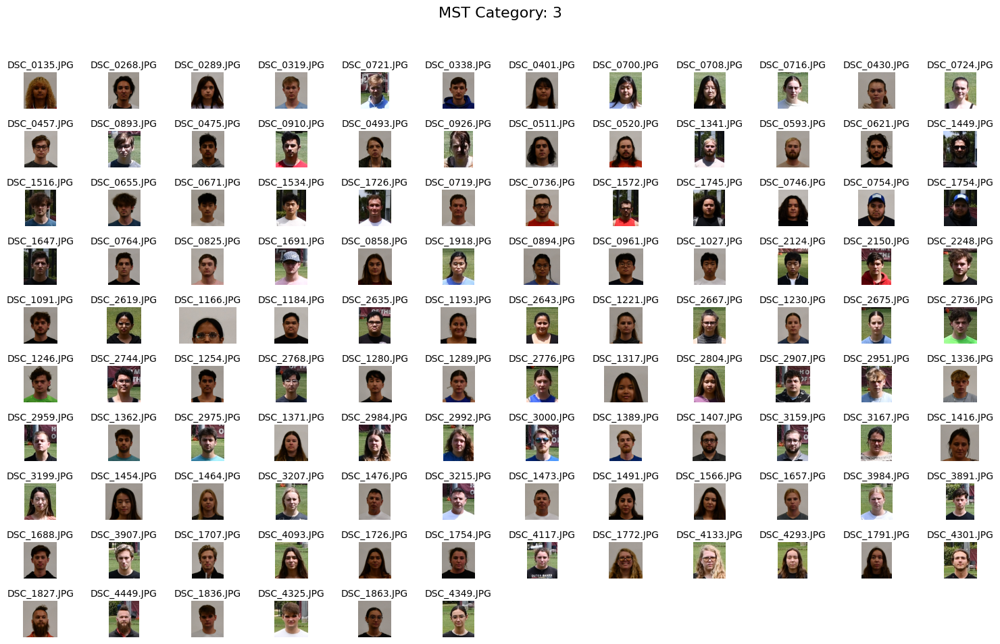

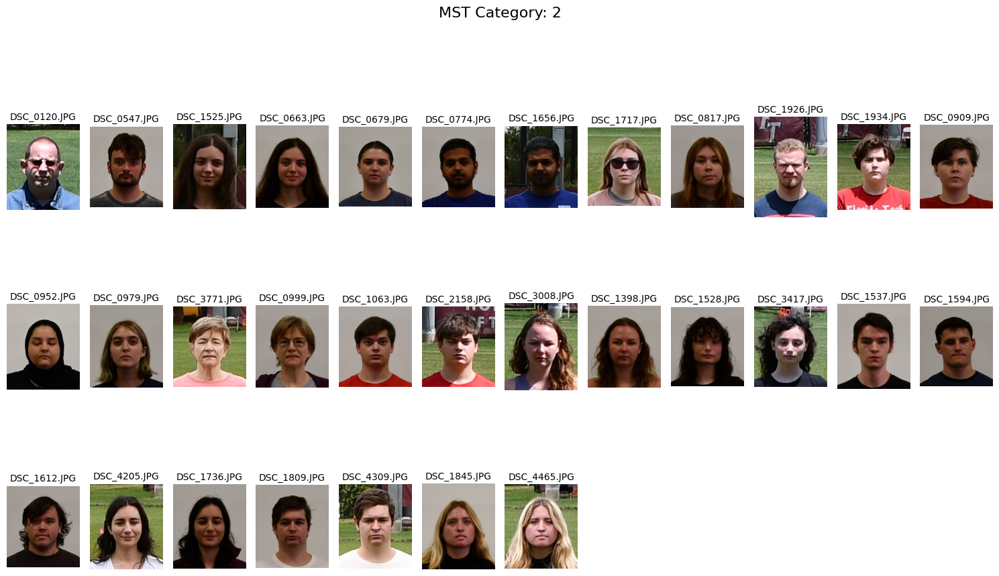

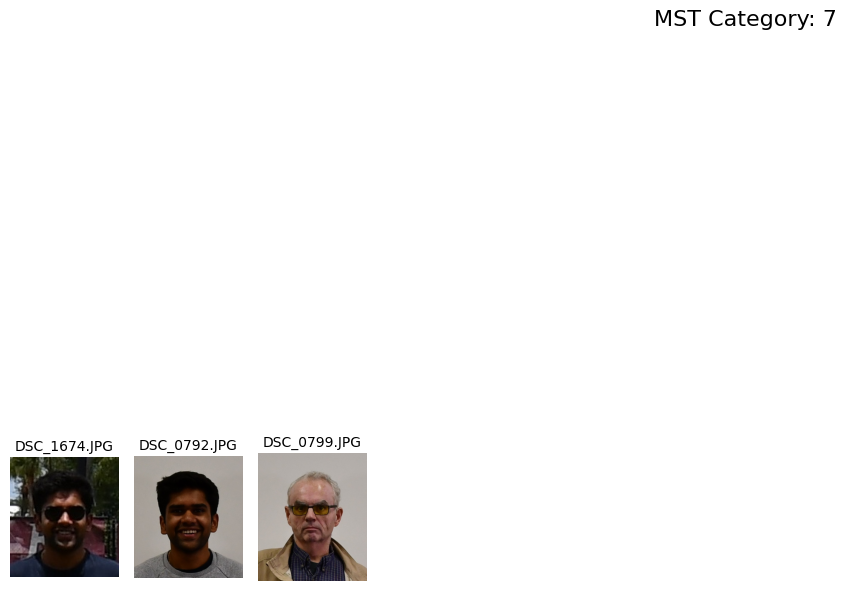

In [8]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import random

base_path = '/home/dasec-notebook/Thesis/Datasets/CHROMA-FIT-Dataset/DATA_CROPPED_PORTRAIT2'
mst_ratings_data = pd.read_csv('baseline_results/ground_truth_RGB_MST_forearm.csv')

mst_categories = mst_ratings_data['Ground_Truth_MST_Orb'].unique()

mst_images = {mst: [] for mst in mst_categories}

for index, row in mst_ratings_data.iterrows():
    folder_id = f"{int(row['ID']):05d}"  # Format the ID to be 5 digits
    folder_path = os.path.join(base_path, folder_id)

    if os.path.exists(folder_path):
        files = os.listdir(folder_path)

        image_files = [f for f in files if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

        for image in image_files:
            mst_images[row['Ground_Truth_MST_Orb']].append(os.path.join(folder_path, image))

# Display images for each MST category
for mst, images in mst_images.items():

    plt.figure(figsize=(15, 10))
    plt.suptitle(f'MST Category: {mst}', fontsize=16)

    num_images = len(images)
    cols = 12  
    rows = (num_images // cols) + (num_images % cols > 0) 

    # Plot each image in a subplot
    for i, img_path in enumerate(images):
        img = plt.imread(img_path)
        ax = plt.subplot(rows, cols, i + 1)
        ax.imshow(img)
        ax.axis('off') 

        file_name = os.path.basename(img_path) 
        ax.set_title(file_name, fontsize=10, pad=5)  


    # Adjust layout to prevent overlap
    plt.tight_layout(rect=[0, 0.03, 1, 0.95]) 
    plt.show()


Display all MST images by their category

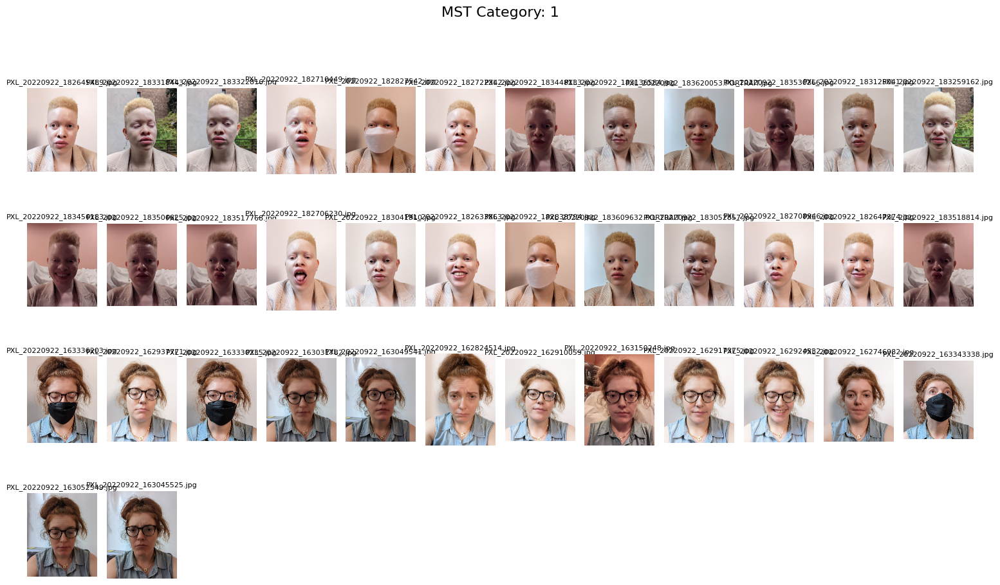

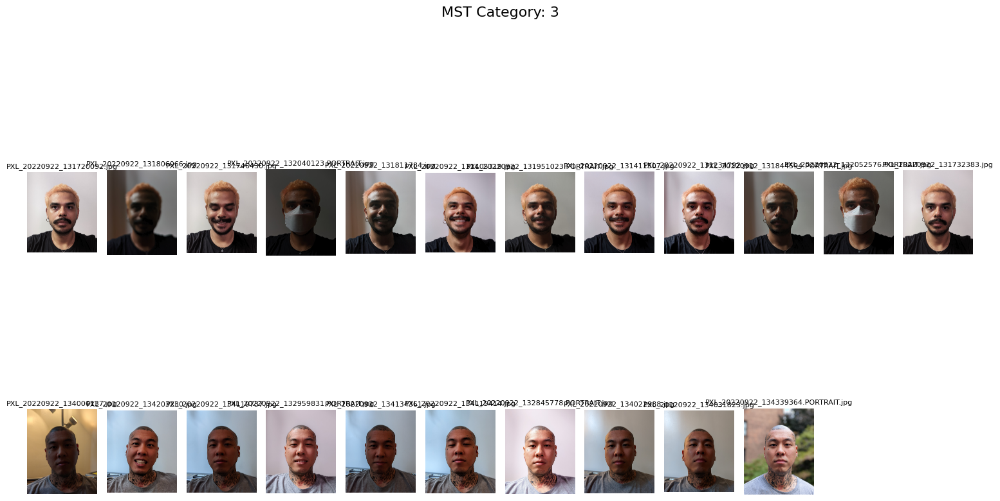

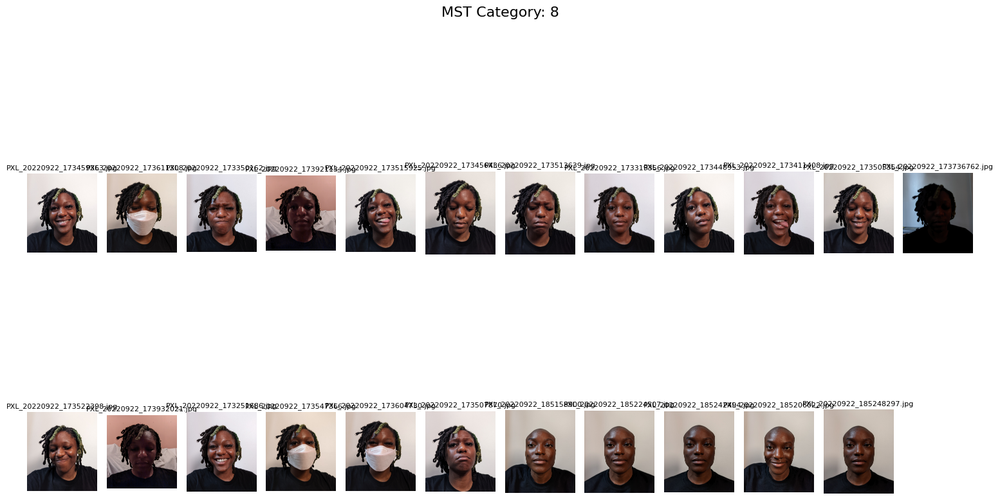

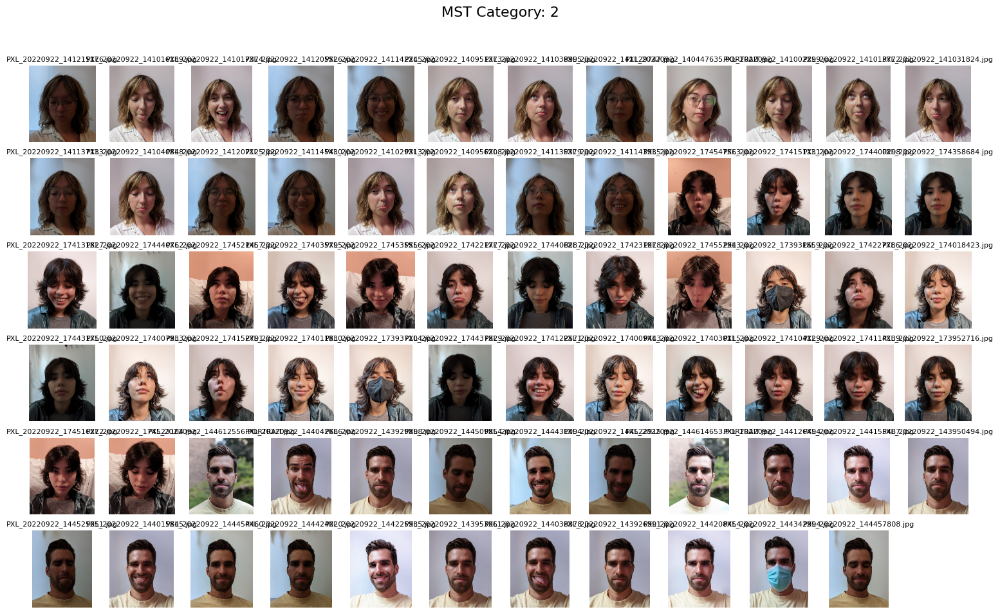

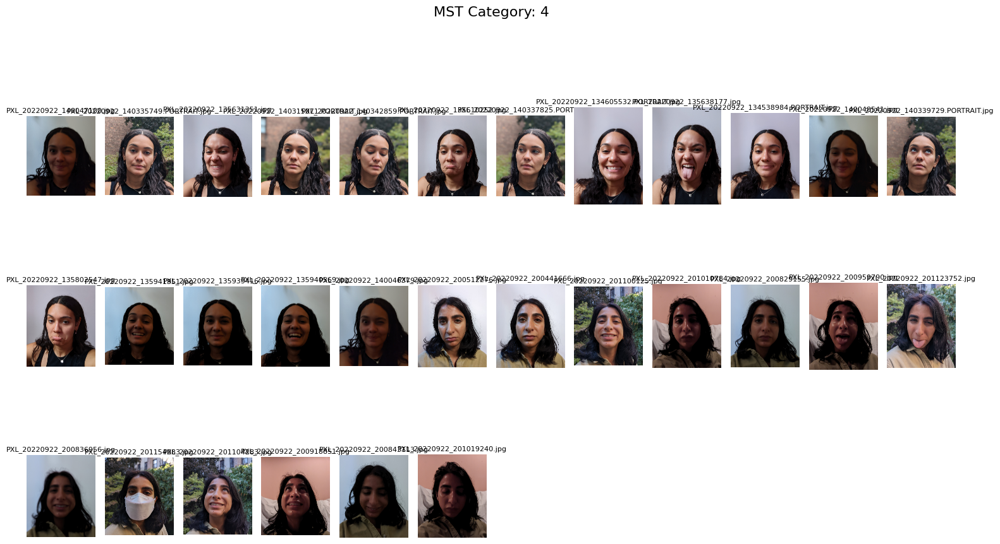

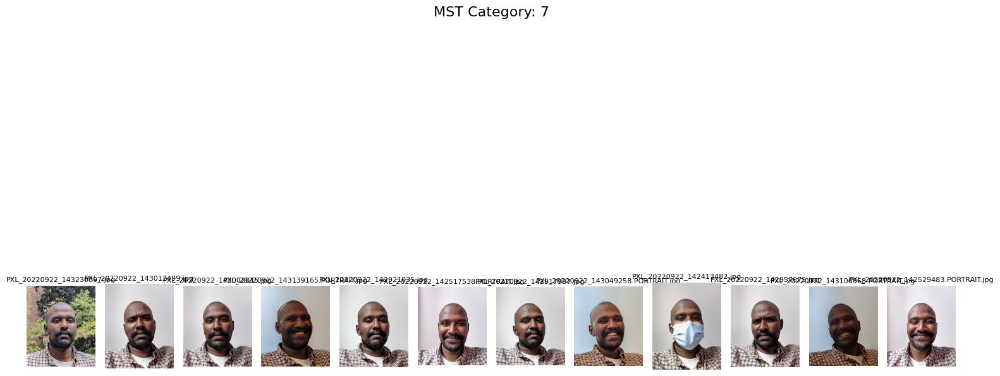

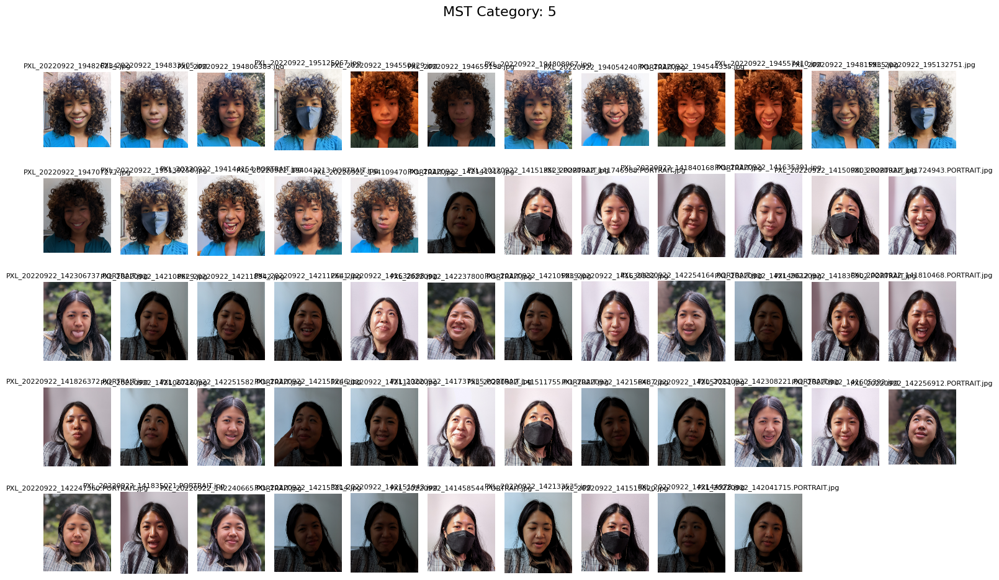

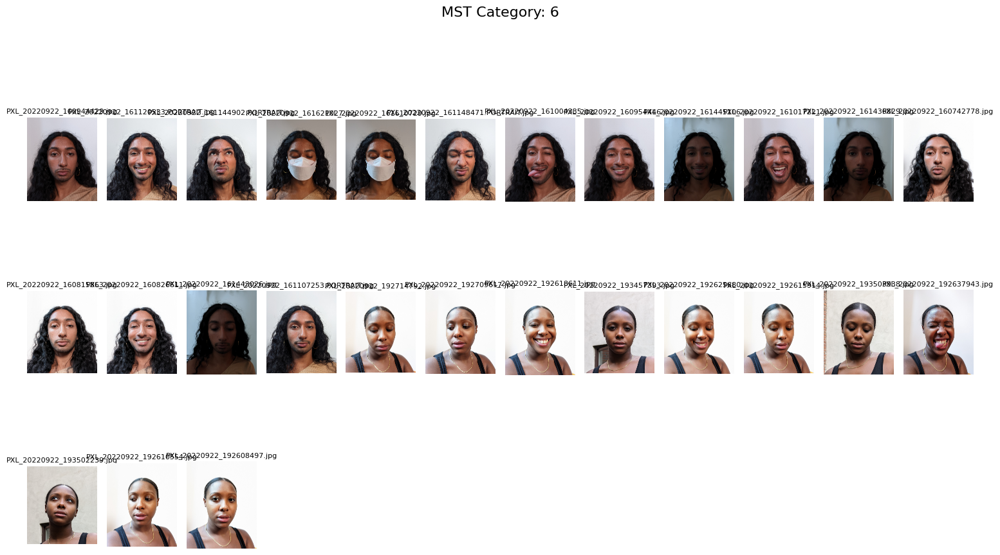

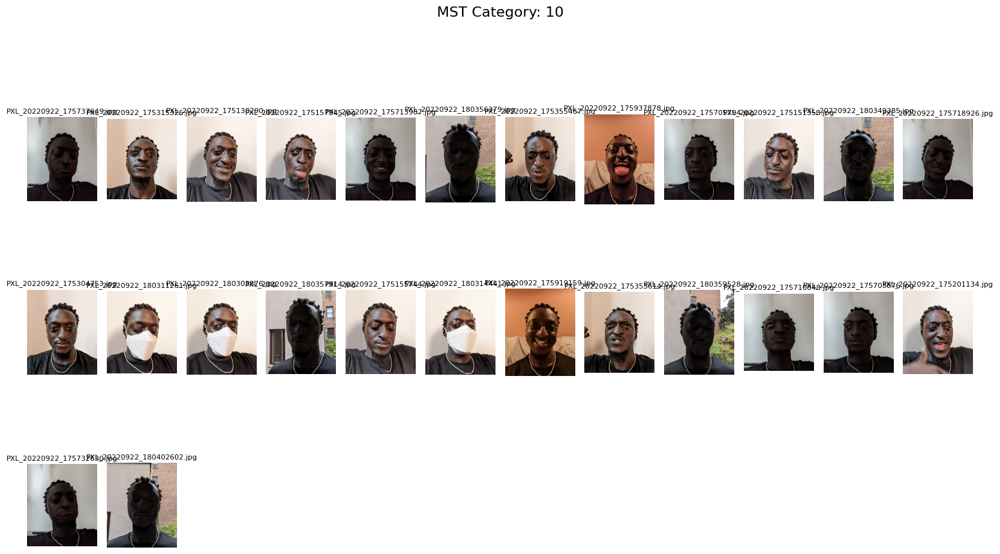

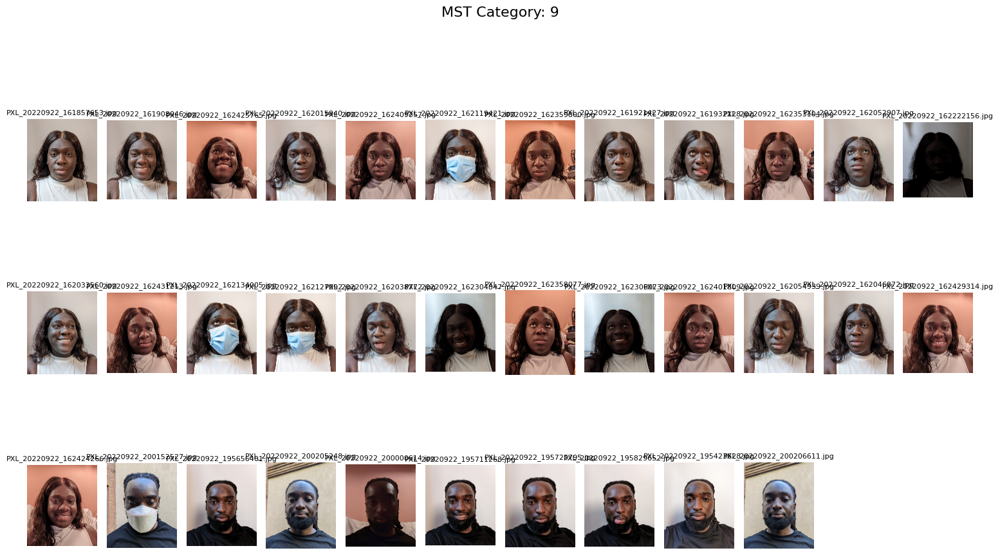

In [105]:
MST_SUBJECT_MAPPING = {
    'subject_18': 1, 'subject_17': 8, 'subject_16': 1, 'subject_15': 3, 'subject_14': 6,
    'subject_13': 2, 'subject_12': 10, 'subject_11': 5, 'subject_10': 9, 'subject_9': 4,
    'subject_8': 2, 'subject_7': 4, 'subject_6': 5, 'subject_5': 7, 'subject_4': 9,
    'subject_3': 6, 'subject_2': 8, 'subject_1': 2, 'subject_0': 3
}

baseline_utils.plot_images_by_mst_category(MST_SUBJECT_MAPPING, '/home/dasec-notebook/Thesis/Datasets/mst-e_data/mst-e_data_portrait')


# Calculate the predicted MST category for CHROMA-FIT dataset

In [96]:
import json

#NOTE: Change the file name to the required one for indoor and outdoor images

results_file = 'baseline_results/CHROMA-FIT_outdoor_cheek_colors_results.json'
save_predicted_file = 'baseline_results/CHROMA-FIT_outdoor_cheek_colors_predicted.csv'
mst_orb_dir = '/home/dasec-notebook/Thesis/Datasets/MST Orbs/orbs'

with open(results_file, 'r') as file:
    mst_data = json.load(file)

# Load all MST orb salient colors in a dictionary
mst_orb_salient_colors = {}
for filename in os.listdir(mst_orb_dir):
    if filename.endswith(".png"):  # Assumes MST orbs are PNG images
        image_path = os.path.join(mst_orb_dir, filename)
        salient_colors = baseline_utils.extract_salient_colors(image_path)
        mst_orb_salient_colors[filename] = salient_colors

# Prepare results
mst_results = []

# # Iterate over each subject in the JSON data
for subject_id, subject_data in mst_data.items():

    for image_name, image_data in subject_data.items():
    
        avg_cheek_rgb = image_data["avg_cheek_color"]
        left_cheek_rgb = image_data["left_cheek_color"]
        right_cheek_rgb = image_data["right_cheek_color"]

        if avg_cheek_rgb != None:

            best_mst_orb, lowest_rmse = baseline_utils.calculate_best_mst_orb(avg_cheek_rgb, mst_orb_salient_colors)

        elif left_cheek_rgb != None:
            best_mst_orb, lowest_rmse = baseline_utils.calculate_best_mst_orb(left_cheek_rgb, mst_orb_salient_colors)

        elif right_cheek_rgb != None:
                best_mst_orb, lowest_rmse = baseline_utils.calculate_best_mst_orb(right_cheek_rgb, mst_orb_salient_colors)
        
        else:
            continue

        mst_results.append({
            'ID': str(int(subject_id)), # subject_id.split('_')[1], #NOTE: switch for CHROMA-fit and MST data formatting
            'Image': image_name,
            'Best_MST_Orb': best_mst_orb,  # Best MST orb file for this subject
            'Lowest_RMSE': lowest_rmse
        })

# # Convert results to DataFrame and save as CSV
results_df = pd.DataFrame(mst_results)
results_df.to_csv(save_predicted_file, index=False)

print("Best MST orbs calculated and saved")

Best MST orbs calculated and saved


# Calculate the prediction accuracy for CHROMA-FIT dataset

In [16]:
ground_truth = pd.read_csv('baseline_results/ground_truth_RGB_MST_forearm.csv')
predictions = pd.read_csv('baseline_results/CHROMA-FIT_indoor_cheek_colors_predicted.csv')
img_file_path = 'baseline_results/indoor_forearm.txt'
save_results_file = 'baseline_results/CHROMA-FIT_indoor_forearm_cheek_colors_accuracy_results.csv'

# Calculate predictions for the images specified in the img_file_path
# Some images were removed from the dataset due to incorrect measurements
with open(img_file_path, 'r') as f:
    img_paths = f.read().splitlines()

img_files = [path.split('/')[-1] for path in img_paths]

filtered_predictions = predictions[predictions['Image'].isin(img_files)]

# Extract ID and Best_MST_Orb columns from the predictions
most_frequent_predictions = filtered_predictions.groupby('ID')['Best_MST_Orb'].agg(lambda x: x.mode()[0]).reset_index()
most_frequent_predictions.columns = ['ID', 'Best_MST_Orb_pred']

merged_data = pd.merge(most_frequent_predictions, ground_truth, on='ID')

results_per_category = {}

# Iterate through each MST category
for category in merged_data['Ground_Truth_MST_Orb'].unique():

    # Filter rows for the current ground truth category
    category_data = merged_data[merged_data['Ground_Truth_MST_Orb'] == category]
    
    exact_match_predictions = (category_data['Best_MST_Orb_pred'] == category_data['Ground_Truth_MST_Orb']).sum()
    
    # Correct the within ±1 and ±2 calculations
    within_pm1_predictions = (abs(category_data['Best_MST_Orb_pred'] - category_data['Ground_Truth_MST_Orb']) <= 1).sum()
    within_pm2_predictions = (abs(category_data['Best_MST_Orb_pred'] - category_data['Ground_Truth_MST_Orb']) <= 2).sum()
    
    # Total predictions (photos) for the current category
    total_predictions = (merged_data['Ground_Truth_MST_Orb'] == category).sum()
    
    results_per_category[category] = {
        'Exact_Match_Accuracy': (exact_match_predictions / total_predictions) * 100 if total_predictions > 0 else 0,
        'PM1_Accuracy': (within_pm1_predictions / total_predictions) * 100 if total_predictions > 0 else 0,
        'PM2_Accuracy': (within_pm2_predictions / total_predictions) * 100 if total_predictions > 0 else 0,
        'Photos_Included': total_predictions
    }

# Print the results for each MST category
for category, metrics in results_per_category.items():
    print(f"MST category {category}: "
          f"Exact Match Accuracy = {metrics['Exact_Match_Accuracy']:.2f}%, "
          f"±1 Category Accuracy = {metrics['PM1_Accuracy']:.2f}%, "
            f"±2 Category Accuracy = {metrics['PM2_Accuracy']:.2f}%, "
          f"Photos Included = {metrics['Photos_Included']}")

results_per_category = dict(sorted(results_per_category.items()))

# Save the results to a CSV file
results_df = pd.DataFrame.from_dict(results_per_category, orient='index')
results_df.to_csv(save_results_file)


MST category 5: Exact Match Accuracy = 0.00%, ±1 Category Accuracy = 5.00%, ±2 Category Accuracy = 5.00%, Photos Included = 20
MST category 6: Exact Match Accuracy = 0.00%, ±1 Category Accuracy = 0.00%, ±2 Category Accuracy = 0.00%, Photos Included = 31
MST category 8: Exact Match Accuracy = 0.00%, ±1 Category Accuracy = 0.00%, ±2 Category Accuracy = 100.00%, Photos Included = 6
MST category 4: Exact Match Accuracy = 10.00%, ±1 Category Accuracy = 37.50%, ±2 Category Accuracy = 37.50%, Photos Included = 40
MST category 3: Exact Match Accuracy = 0.00%, ±1 Category Accuracy = 0.00%, ±2 Category Accuracy = 13.79%, Photos Included = 58
MST category 1: Exact Match Accuracy = 0.00%, ±1 Category Accuracy = 0.00%, ±2 Category Accuracy = 0.00%, Photos Included = 3
MST category 2: Exact Match Accuracy = 0.00%, ±1 Category Accuracy = 0.00%, ±2 Category Accuracy = 0.00%, Photos Included = 18
MST category 7: Exact Match Accuracy = 0.00%, ±1 Category Accuracy = 0.00%, ±2 Category Accuracy = 0.00%, P

# Calculate the prediction accuracy for MST dataset

In [104]:
mst_results_save = "baseline_results/MST_cheek_colors_accuracy_results.csv"
prediction_file = "baseline_results/MST_cheek_colors_predicted.csv"

MST_SUBJECT_MAPPING = {
    'subject_18': 1,
    'subject_17': 8,
    'subject_16': 1,
    'subject_15': 3,
    'subject_14': 6,
    'subject_13': 2,
    'subject_12': 10,
    'subject_11': 5,
    'subject_10': 9,
    'subject_9': 4,
    'subject_8': 2,
    'subject_7': 4,
    'subject_6': 5,
    'subject_5': 7,
    'subject_4': 9,
    'subject_3': 6,
    'subject_2': 8,
    'subject_1': 2,
    'subject_0': 3
}

import pandas as pd

ground_truth_df = pd.DataFrame(list(MST_SUBJECT_MAPPING.items()), columns=['Subject', 'Best_MST_Orb'])

# Create an 'ID' column that corresponds to the subject IDs
ground_truth_df['ID'] = ground_truth_df['Subject'].str.extract('(\d+)').astype(int)

predictions = pd.read_csv(prediction_file)
merged_data = pd.merge(predictions, ground_truth_df[['ID', 'Best_MST_Orb']], on='ID', suffixes=('', '_truth'))
merged_data.rename(columns={'Best_MST_Orb_truth': 'Ground_Truth_MST_Orb'}, inplace=True)

results_per_category = {}

# Loop over each unique MST category in the ground truth
for category in merged_data['Ground_Truth_MST_Orb'].unique():

    category_data = merged_data[merged_data['Ground_Truth_MST_Orb'] == category]
    
    exact_match_predictions = (category_data['Best_MST_Orb'] == category_data['Ground_Truth_MST_Orb']).sum()
    
    # Correct the within ±1 and ±2 calculations
    within_pm1_predictions = (abs(category_data['Best_MST_Orb'] - category_data['Ground_Truth_MST_Orb']) <= 1).sum()
    within_pm2_predictions = (abs(category_data['Best_MST_Orb'] - category_data['Ground_Truth_MST_Orb']) <= 2).sum()
    
    total_predictions = (merged_data['Ground_Truth_MST_Orb'] == category).sum()
    
    # Save all metrics in a dictionary for the current category
    results_per_category[category] = {
        'Exact_Match_Accuracy': (exact_match_predictions / total_predictions) * 100 if total_predictions > 0 else 0,
        'PM1_Accuracy': (within_pm1_predictions / total_predictions) * 100 if total_predictions > 0 else 0,
        'PM2_Accuracy': (within_pm2_predictions / total_predictions) * 100 if total_predictions > 0 else 0,
        'Photos_Included': total_predictions
    }

# Sort the results by MST category in ascending order
results_per_category = dict(sorted(results_per_category.items()))

# Print the results for each MST category
for category, metrics in results_per_category.items():
    print(f"MST category {category}: "
          f"Exact Match Accuracy = {metrics['Exact_Match_Accuracy']:.2f}%, "
          f"±1 Category Accuracy = {metrics['PM1_Accuracy']:.2f}%, "
          f"±2 Category Accuracy = {metrics['PM2_Accuracy']:.2f}%, "
          f"Photos Included = {metrics['Photos_Included']}")

# Save the results to a CSV file
results_df = pd.DataFrame.from_dict(results_per_category, orient='index')
results_df.to_csv(mst_results_save)



MST category 1: Exact Match Accuracy = 60.00%, ±1 Category Accuracy = 60.00%, ±2 Category Accuracy = 60.00%, Photos Included = 35
MST category 2: Exact Match Accuracy = 0.00%, ±1 Category Accuracy = 32.35%, ±2 Category Accuracy = 41.18%, Photos Included = 68
MST category 3: Exact Match Accuracy = 0.00%, ±1 Category Accuracy = 0.00%, ±2 Category Accuracy = 52.38%, Photos Included = 21
MST category 4: Exact Match Accuracy = 3.45%, ±1 Category Accuracy = 6.90%, ±2 Category Accuracy = 6.90%, Photos Included = 29
MST category 5: Exact Match Accuracy = 5.45%, ±1 Category Accuracy = 16.36%, ±2 Category Accuracy = 16.36%, Photos Included = 55
MST category 6: Exact Match Accuracy = 0.00%, ±1 Category Accuracy = 24.00%, ±2 Category Accuracy = 32.00%, Photos Included = 25
MST category 7: Exact Match Accuracy = 0.00%, ±1 Category Accuracy = 0.00%, ±2 Category Accuracy = 33.33%, Photos Included = 12
MST category 8: Exact Match Accuracy = 0.00%, ±1 Category Accuracy = 23.81%, ±2 Category Accuracy = 